# Location and Demographic Analysis for EV Charging Infrastructure

This notebook analyzes the spatial and demographic factors affecting EV charging infrastructure deployment in the Kitchener-Waterloo region by examining:

1. Population Density Analysis
   - Spatial distribution patterns
   - Density clustering
   - High-density area identification

2. Demographics and Income Analysis
   - Income distribution by density cluster
   - Employment patterns
   - Socioeconomic indicators

3. Housing Characteristics
   - Building types and age distribution
   - Property values and rental patterns
   - Infrastructure readiness assessment

4. Transit Accessibility
   - Public transit coverage analysis
   - Service gaps identification
   - Multi-modal transportation patterns

This analysis provides foundational insights for both new charging station placement and existing infrastructure enhancement.

In [2]:
# Setup and Data Loading
import pandas as pd
import numpy as np
import geopandas as gpd
import matplotlib.pyplot as plt
import seaborn as sns
from pathlib import Path
import folium
from datetime import datetime
import logging
import warnings
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler
from scipy.stats import gaussian_kde
from IPython.display import display, Markdown
from tqdm import tqdm

# Local imports
from src.data.data_manager import DataManager
from src.data.constants import *
from src.data.utils import *
from src.visualization.map_viz import *

# Configure logging and warnings
logging.basicConfig(level=logging.INFO)
logger = logging.getLogger(__name__)
warnings.filterwarnings('ignore')

# Initialize data manager
data_mgr = DataManager()

# Load processed data from previous notebook
print("\033[1m\033[94mLoading processed data...\033[0m")
population_data = load_latest_file(DATA_PATHS['population'], 'geojson')
charging_stations = load_latest_file(DATA_PATHS['charging_stations'], 'csv')
potential_locations = load_latest_file(DATA_PATHS['potential_locations'], 'csv')
integrated_data = load_latest_file(DATA_PATHS['integrated_analyzed_data'], 'geojson')

# Print out the ones successfully loaded
print("\033[1m\033[92mData loaded successfully!\033[0m")
print(f"\033[1m\033[92m✔\033[0m Population data: {population_data.shape}")
print(f"\033[1m\033[92m✔\033[0m Charging stations: {charging_stations.shape}")
print(f"\033[1m\033[92m✔\033[0m Potential locations: {potential_locations.shape}")
print(f"\033[1m\033[92m✔\033[0m Integrated data: {integrated_data.shape}")

print("\033[1m\033[92mSetup complete!\033[0m")

Loading processed data...
Data loaded successfully!
✔ Population data: (381, 96)
✔ Charging stations: (183, 10)
✔ Potential locations: (7705, 8)
✔ Integrated data: (1, 24)
Setup complete!


## 1. Population Density Analysis
First, let's analyze the spatial distribution of population density to identify high-demand areas.

In [3]:
# Basic density statistics
print("\033[1mAnalyzing Population Density Patterns\033[0m")
print("=" * 80)

density_stats = population_data.loc[
    population_data['data_source'] == 'Region of Waterloo', 
    'population_density'
].describe()

print("\n📊 Population Density Statistics (people/km²):")
print("-" * 50)
for stat, value in density_stats.items():
    print(f"{stat:15}: {value:,.2f}")

# Create clean dataset for clustering
clean_data = population_data.copy()
clean_data = clean_data[
    ~clean_data['population_density'].isna() & 
    ~clean_data.geometry.centroid.x.isna() & 
    ~clean_data.geometry.centroid.y.isna()
]

# Prepare data for clustering
coords = np.column_stack((
    clean_data.geometry.centroid.x,
    clean_data.geometry.centroid.y
))
weights = clean_data['population_density'].values

# Perform density clustering
scaler = StandardScaler()
scaled_data = scaler.fit_transform(np.column_stack((coords, weights.reshape(-1, 1))))
clustering = DBSCAN(eps=0.5, min_samples=2).fit(scaled_data)

# Add cluster labels
clean_data['density_cluster'] = clustering.labels_
population_data['density_cluster'] = -1  # Initialize all as noise
population_data.loc[clean_data.index, 'density_cluster'] = clustering.labels_

# Calculate comprehensive cluster statistics
cluster_stats = population_data.loc[
    population_data['data_source'] == 'Region of Waterloo'
].groupby('density_cluster').agg({
    'population': 'sum',
    'area_km2': 'sum',
    'population_density': ['mean', 'min', 'max'],
    'HHLD_DWELL_VALUE_MED': 'mean',
    'HHLD_TNT_RENT_MONTH_COST_MED': 'mean',
    'DWELL_OWNER': 'sum',
    'DWELL_RENTER': 'sum'
}).round(2)

# Create summary table
summary_table = pd.DataFrame({
    'Points': [len(clean_data[clean_data['density_cluster'] == cid]) for cid in cluster_stats.index],
    'Population': cluster_stats[('population', 'sum')],
    'Area (km²)': cluster_stats[('area_km2', 'sum')],
    'Avg Density (/km²)': cluster_stats[('population_density', 'mean')],
    'Min Density (/km²)': cluster_stats[('population_density', 'min')],
    'Max Density (/km²)': cluster_stats[('population_density', 'max')],
    'Median Home Value ($)': cluster_stats[('HHLD_DWELL_VALUE_MED', 'mean')],
    'Median Rent ($)': cluster_stats[('HHLD_TNT_RENT_MONTH_COST_MED', 'mean')],
    'Owner/Renter Ratio': cluster_stats[('DWELL_OWNER', 'sum')] / cluster_stats[('DWELL_RENTER', 'sum')]
})

# Format numeric columns
for col in summary_table.columns:
    if 'Density' in col:
        summary_table[col] = summary_table[col].map('{:,.1f}'.format)
    elif 'Population' in col:
        summary_table[col] = summary_table[col].map('{:,.0f}'.format)
    elif 'Area' in col:
        summary_table[col] = summary_table[col].map('{:,.1f}'.format)
    elif 'Value' in col or 'Rent' in col:
        summary_table[col] = summary_table[col].map('${:,.0f}'.format)
    elif 'Ratio' in col:
        summary_table[col] = summary_table[col].map('{:.2f}'.format)

# Update index names
summary_table.index = ['Noise Points' if x == -1 else f'Cluster {x}' for x in summary_table.index]

print("\n📊 Cluster Analysis:")
print("-" * 50)
display(summary_table)

Analyzing Population Density Patterns

📊 Population Density Statistics (people/km²):
--------------------------------------------------
count          : 379.00
mean           : 1,487.99
std            : 1,274.69
min            : 19.41
25%            : 792.41
50%            : 1,225.75
75%            : 1,777.56
max            : 12,687.77

📊 Cluster Analysis:
--------------------------------------------------


,Points,Population,Area (km²),Avg Density (/km²),Min Density (/km²),Max Density (/km²),Median Home Value ($),Median Rent ($),Owner/Renter Ratio
Noise Points,16,"342,845","2,079.0","3,475.9",19.4,"12,687.8","$605,812","$1,220",$2
Cluster 0,23,"17,255",43.5,682.9,117.1,"1,821.9","$799,217","$1,676",$4
Cluster 1,3,765,0.3,"2,592.4","2,510.6","2,685.9","$500,000","$1,467",$0
Cluster 2,325,"263,060",308.3,"1,383.0",55.9,"4,701.9","$635,681","$1,321",$1
Cluster 3,2,"2,035",11.7,160.6,25.6,295.6,"$1,300,000","$1,370",$1
Cluster 4,2,725,0.1,"4,982.8","4,878.3","5,087.3","$448,000","$1,040",$0
Cluster 5,2,"6,150",21.6,285.4,285.4,285.4,"$750,000","$2,000",$3
Cluster 6,2,"3,335",22.4,160.5,118.1,202.8,"$800,000","$2,240",$6
Cluster 7,2,835,0.3,"3,170.8","2,874.7","3,466.8","$350,000","$1,040",$0
Cluster 8,2,725,0.1,"8,931.7","8,711.7","9,151.7","$537,000","$1,290",$0


In [4]:
# Visualize density clusters
m = create_kwc_map("Population Density Clusters", kwc=True)
m = plot_population_density_map(m, population_data)
m = plot_density_clusters(m, clean_data, clustering.labels_)
draw_map(m)

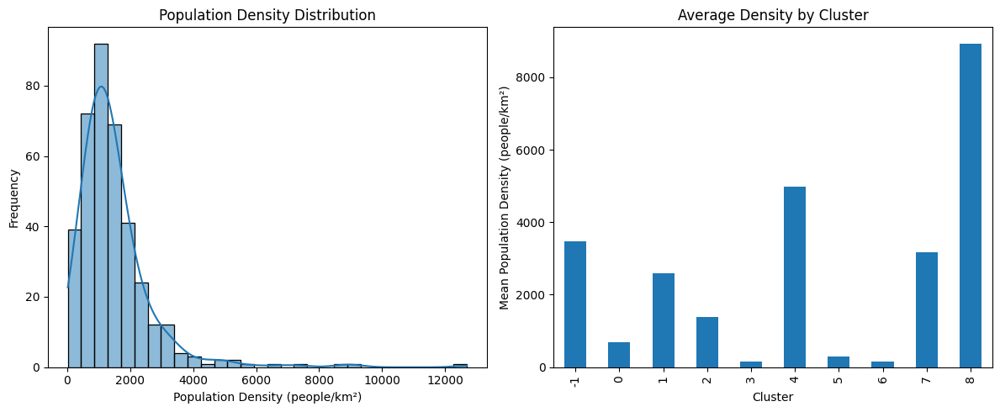

In [5]:
# Create density distribution plots
plt.figure(figsize=(12, 5))

# Population Density Distribution
plt.subplot(1, 2, 1)
sns.histplot(data=clean_data, x='population_density', bins=30, kde=True)
plt.title('Population Density Distribution')
plt.xlabel('Population Density (people/km²)')
plt.ylabel('Frequency')

# Average Density by Cluster
plt.subplot(1, 2, 2)
cluster_means = clean_data.groupby('density_cluster')['population_density'].mean()
cluster_means.plot(kind='bar')
plt.title('Average Density by Cluster')
plt.xlabel('Cluster')
plt.ylabel('Mean Population Density (people/km²)')

plt.tight_layout()
plt.show()

## 2. Demographics and Income Analysis

Now let's analyze demographic and socioeconomic factors that influence EV charging demand, including:
- Income distribution across density clusters
- Employment patterns
- Relationship between income and population density

In [6]:
print("\033[1mAnalyzing Demographics and Socioeconomic Patterns\033[0m")
print("=" * 80)

# Calculate comprehensive demographic statistics
demographic_stats = population_data.loc[
    population_data['data_source'] == 'Region of Waterloo'
].groupby('density_cluster').agg({
    'population': 'sum',
    'HHLD_DWELL_VALUE_MED': 'mean',
    'HHLD_TNT_RENT_MONTH_COST_MED': 'mean',
    'DWELL_OWNER': 'sum',
    'DWELL_RENTER': 'sum'
}).round(2)

# Calculate ownership rates
demographic_stats['ownership_rate'] = (
    demographic_stats['DWELL_OWNER'] / 
    (demographic_stats['DWELL_OWNER'] + demographic_stats['DWELL_RENTER']) * 100
).round(1)

# Format the table
demographic_summary = pd.DataFrame({
    'Population': demographic_stats['population'],
    'Ownership Rate (%)': demographic_stats['ownership_rate'],
    'Median Home Value': demographic_stats['HHLD_DWELL_VALUE_MED'],
    'Median Monthly Rent': demographic_stats['HHLD_TNT_RENT_MONTH_COST_MED']
})

# Format columns
demographic_summary['Population'] = demographic_summary['Population'].map('{:,.0f}'.format)
demographic_summary['Ownership Rate (%)'] = demographic_summary['Ownership Rate (%)'].map('{:.1f}%'.format)
demographic_summary['Median Home Value'] = demographic_summary['Median Home Value'].map('${:,.0f}'.format)
demographic_summary['Median Monthly Rent'] = demographic_summary['Median Monthly Rent'].map('${:,.0f}'.format)

# Update index names
demographic_summary.index = ['Noise Points' if x == -1 else f'Cluster {x}' for x in demographic_summary.index]

print("\n📊 Demographic Summary by Cluster:")
print("-" * 50)
display(demographic_summary)

# Calculate regional totals
total_pop = population_data['population'].sum()
total_owners = population_data['DWELL_OWNER'].sum()
total_renters = population_data['DWELL_RENTER'].sum()
overall_ownership_rate = (total_owners / (total_owners + total_renters)) * 100

print(f"\n📊 Regional Housing Overview:")
print("-" * 50)
print(f"Total Population: {total_pop:,.0f}")
print(f"Owner-Occupied Units: {total_owners:,.0f}")
print(f"Rental Units: {total_renters:,.0f}")
print(f"Overall Ownership Rate: {overall_ownership_rate:.1f}%")

Analyzing Demographics and Socioeconomic Patterns

📊 Demographic Summary by Cluster:
--------------------------------------------------


,Population,Ownership Rate (%),Median Home Value,Median Monthly Rent
Noise Points,"342,845",65.7%,"$605,812","$1,220"
Cluster 0,"17,255",81.2%,"$799,217","$1,676"
Cluster 1,765,29.6%,"$500,000","$1,467"
Cluster 2,"263,060",58.6%,"$635,681","$1,321"
Cluster 3,"2,035",38.8%,"$1,300,000","$1,370"
Cluster 4,725,17.1%,"$448,000","$1,040"
Cluster 5,"6,150",72.8%,"$750,000","$2,000"
Cluster 6,"3,335",85.2%,"$800,000","$2,240"
Cluster 7,835,21.0%,"$350,000","$1,040"
Cluster 8,725,26.9%,"$537,000","$1,290"



📊 Regional Housing Overview:
--------------------------------------------------
Total Population: 1,260,227
Owner-Occupied Units: 402,275
Rental Units: 235,280
Overall Ownership Rate: 63.1%


INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should

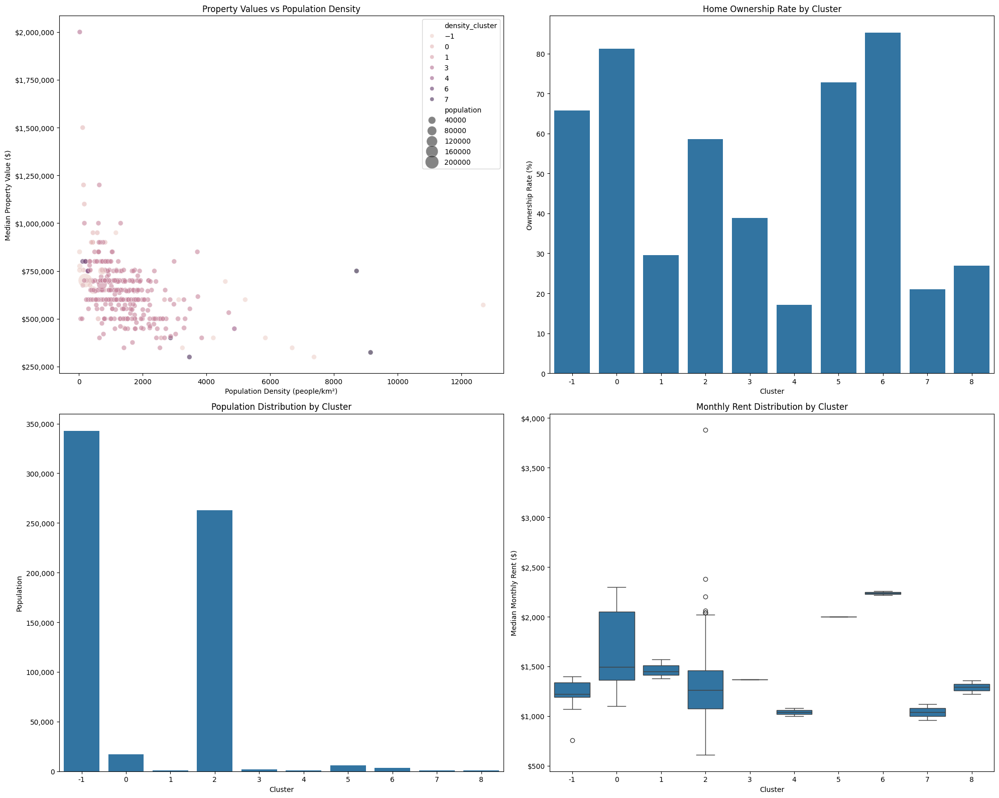

In [7]:
# Create comprehensive demographic visualizations
fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 16))

# 1. Property Values vs Population Density Scatter
sns.scatterplot(
    data=population_data[population_data['data_source'] == 'Region of Waterloo'],
    x='population_density',
    y='HHLD_DWELL_VALUE_MED',
    hue='density_cluster',
    size='population',
    sizes=(50, 400),
    alpha=0.6,
    ax=ax1
)
ax1.set_title('Property Values vs Population Density')
ax1.set_xlabel('Population Density (people/km²)')
ax1.set_ylabel('Median Property Value ($)')
ax1.yaxis.set_major_formatter(plt.FuncFormatter(lambda x, p: f'${x:,.0f}'))

# 2. Ownership Rate by Cluster
ownership_data = demographic_stats['ownership_rate'].reset_index()
ownership_data.columns = ['cluster', 'rate']
sns.barplot(
    data=ownership_data,
    x='cluster',
    y='rate',
    ax=ax2
)
ax2.set_title('Home Ownership Rate by Cluster')
ax2.set_xlabel('Cluster')
ax2.set_ylabel('Ownership Rate (%)')

# 3. Population Distribution by Cluster
pop_data = demographic_stats['population'].reset_index()
pop_data.columns = ['cluster', 'population']
sns.barplot(
    data=pop_data,
    x='cluster',
    y='population',
    ax=ax3
)
ax3.set_title('Population Distribution by Cluster')
ax3.set_xlabel('Cluster')
ax3.set_ylabel('Population')
ax3.yaxis.set_major_formatter(plt.FuncFormatter(lambda x, p: f'{x:,.0f}'))

# 4. Monthly Rent Distribution
sns.boxplot(
    data=population_data[population_data['data_source'] == 'Region of Waterloo'],
    x='density_cluster',
    y='HHLD_TNT_RENT_MONTH_COST_MED',
    ax=ax4
)
ax4.set_title('Monthly Rent Distribution by Cluster')
ax4.set_xlabel('Cluster')
ax4.set_ylabel('Median Monthly Rent ($)')
ax4.yaxis.set_major_formatter(plt.FuncFormatter(lambda x, p: f'${x:,.0f}'))

plt.tight_layout()
plt.show()

In [8]:
display(Markdown(f"""
### Key Demographic Insights:

1. Property Values and Density
   - Strong relationship between density and property values
   - Higher-density clusters show more property value variation
   - Property values highest in clusters {demographic_stats['HHLD_DWELL_VALUE_MED'].idxmax()}

2. Housing Tenure Patterns
   - Overall ownership rate: {overall_ownership_rate:.1f}%
   - Ownership rates vary significantly by cluster
   - Higher density areas show more rental properties

3. Implications for EV Charging
   - Higher value areas may see faster EV adoption
   - Different charging solutions needed for rental vs owned properties
   - Property values suggest varying ability to support infrastructure costs
"""))


### Key Demographic Insights:

1. Property Values and Density
   - Strong relationship between density and property values
   - Higher-density clusters show more property value variation
   - Property values highest in clusters 3

2. Housing Tenure Patterns
   - Overall ownership rate: 63.1%
   - Ownership rates vary significantly by cluster
   - Higher density areas show more rental properties

3. Implications for EV Charging
   - Higher value areas may see faster EV adoption
   - Different charging solutions needed for rental vs owned properties
   - Property values suggest varying ability to support infrastructure costs


## 3. Housing Characteristics Analysis

After analyzing demographics and property values, let's examine the physical housing characteristics that influence EV charging infrastructure needs:
- Housing age and infrastructure readiness
- Building types (single family vs. multi-unit)
- Housing density patterns

In [9]:
print("\033[1mAnalyzing Housing Stock and Building Types\033[0m")
print("=" * 80)

# Calculate housing statistics by cluster
housing_stats = population_data.loc[
    population_data['data_source'] == 'Region of Waterloo'
].groupby('density_cluster').agg({
    'DWELL_OWNER': 'sum',
    'DWELL_RENTER': 'sum',
    'DWELL_CONDO': 'sum',
    'DWELL_NOT_CONDO': 'sum',
    'DWELL_1_BEDROOM': 'sum',
    'DWELL_2_BEDROOM': 'sum',
    'DWELL_3_BEDROOM': 'sum',
    'DWELL_4_OR_MORE_BEDROOM': 'sum'
}).round(2)

# Create readable summary table
housing_summary = pd.DataFrame({
    'Total Units': housing_stats['DWELL_OWNER'] + housing_stats['DWELL_RENTER'],
    'Single Family (%)': (housing_stats['DWELL_NOT_CONDO'] / (housing_stats['DWELL_CONDO'] + housing_stats['DWELL_NOT_CONDO']) * 100),
    'Multi-Unit (%)': (housing_stats['DWELL_CONDO'] / (housing_stats['DWELL_CONDO'] + housing_stats['DWELL_NOT_CONDO']) * 100),
    'Small Units (1-2 BR)': housing_stats['DWELL_1_BEDROOM'] + housing_stats['DWELL_2_BEDROOM'],
    'Large Units (3+ BR)': housing_stats['DWELL_3_BEDROOM'] + housing_stats['DWELL_4_OR_MORE_BEDROOM']
})

# Format columns
housing_summary['Total Units'] = housing_summary['Total Units'].map('{:,.0f}'.format)
housing_summary['Single Family (%)'] = housing_summary['Single Family (%)'].map('{:.1f}'.format)
housing_summary['Multi-Unit (%)'] = housing_summary['Multi-Unit (%)'].map('{:.1f}'.format)
housing_summary['Small Units (1-2 BR)'] = housing_summary['Small Units (1-2 BR)'].map('{:,.0f}'.format)
housing_summary['Large Units (3+ BR)'] = housing_summary['Large Units (3+ BR)'].map('{:,.0f}'.format)

# Update index names
housing_summary.index = ['Noise Points' if x == -1 else f'Cluster {x}' for x in housing_summary.index]

print("\n📊 Housing Stock Analysis by Cluster:")
print("-" * 50)
display(housing_summary)

Analyzing Housing Stock and Building Types

📊 Housing Stock Analysis by Cluster:
--------------------------------------------------


,Total Units,Single Family (%),Multi-Unit (%),Small Units (1-2 BR),Large Units (3+ BR)
Noise Points,"342,860",86.0,14.0,"113,865","227,560"
Cluster 0,"17,250",81.4,18.6,"2,505","14,685"
Cluster 1,760,69.9,30.1,340,410
Cluster 2,"262,870",86.6,13.4,"103,270","157,820"
Cluster 3,"2,035",96.1,3.9,"1,180",850
Cluster 4,730,78.1,21.9,570,155
Cluster 5,"6,150",78.1,21.9,"1,060","5,070"
Cluster 6,"3,340",89.2,10.8,140,"3,190"
Cluster 7,835,73.2,26.8,530,280
Cluster 8,725,75.9,24.1,660,75


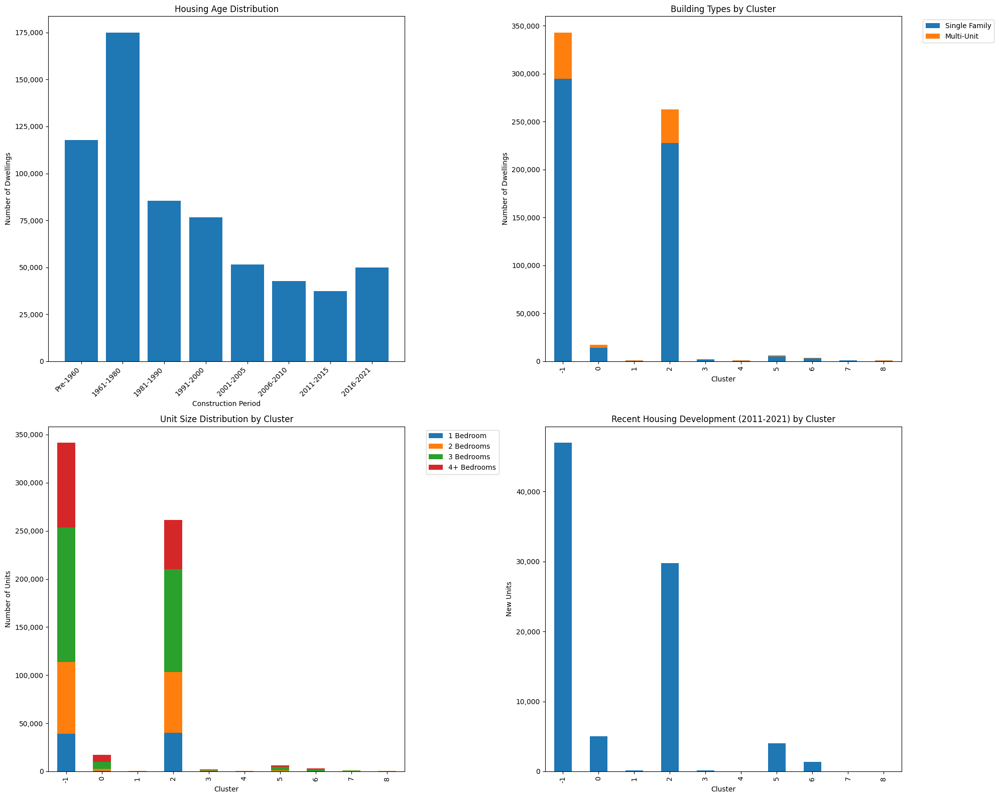

In [10]:
# Analyze housing age distribution
housing_age_cols = [
    'DWELL_PERIOD_1960_OR_BEFORE',
    'DWELL_PERIOD_1961_1980',
    'DWELL_PERIOD_1981_1990',
    'DWELL_PERIOD_1991_2000',
    'DWELL_PERIOD_2001_2005',
    'DWELL_PERIOD_2006_2010',
    'DWELL_PERIOD_2011_2015',
    'DWELL_PERIOD_2016_2021'
]

# Create age distribution by cluster
housing_age = population_data.loc[
    population_data['data_source'] == 'Region of Waterloo',
    housing_age_cols + ['density_cluster']
].groupby('density_cluster')[housing_age_cols].sum()

# Create visualizations
fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 16))

# 1. Overall Housing Age Distribution
period_labels = [
    'Pre-1960',
    '1961-1980',
    '1981-1990',
    '1991-2000',
    '2001-2005',
    '2006-2010',
    '2011-2015',
    '2016-2021'
]

total_by_age = housing_age.sum()
ax1.bar(range(len(period_labels)), total_by_age)
ax1.set_title('Housing Age Distribution')
ax1.set_xlabel('Construction Period')
ax1.set_ylabel('Number of Dwellings')
ax1.set_xticks(range(len(period_labels)))
ax1.set_xticklabels(period_labels, rotation=45, ha='right')
ax1.yaxis.set_major_formatter(plt.FuncFormatter(lambda x, p: f'{int(x):,}'))

# 2. Building Type Distribution by Cluster
dwelling_types = pd.DataFrame({
    'Single Family': housing_stats['DWELL_NOT_CONDO'],
    'Multi-Unit': housing_stats['DWELL_CONDO']
})
dwelling_types.plot(kind='bar', stacked=True, ax=ax2)
ax2.set_title('Building Types by Cluster')
ax2.set_xlabel('Cluster')
ax2.set_ylabel('Number of Dwellings')
ax2.yaxis.set_major_formatter(plt.FuncFormatter(lambda x, p: f'{int(x):,}'))
ax2.legend(bbox_to_anchor=(1.05, 1), loc='upper left')

# 3. Unit Size Distribution
unit_sizes = pd.DataFrame({
    '1 Bedroom': housing_stats['DWELL_1_BEDROOM'],
    '2 Bedrooms': housing_stats['DWELL_2_BEDROOM'],
    '3 Bedrooms': housing_stats['DWELL_3_BEDROOM'],
    '4+ Bedrooms': housing_stats['DWELL_4_OR_MORE_BEDROOM']
})
unit_sizes.plot(kind='bar', stacked=True, ax=ax3)
ax3.set_title('Unit Size Distribution by Cluster')
ax3.set_xlabel('Cluster')
ax3.set_ylabel('Number of Units')
ax3.yaxis.set_major_formatter(plt.FuncFormatter(lambda x, p: f'{int(x):,}'))
ax3.legend(bbox_to_anchor=(1.05, 1), loc='upper left')

# 4. Recent Development Focus (2010-2021)
recent_housing = housing_age[['DWELL_PERIOD_2011_2015', 'DWELL_PERIOD_2016_2021']].sum(axis=1)
recent_housing.plot(kind='bar', ax=ax4)
ax4.set_title('Recent Housing Development (2011-2021) by Cluster')
ax4.set_xlabel('Cluster')
ax4.set_ylabel('New Units')
ax4.yaxis.set_major_formatter(plt.FuncFormatter(lambda x, p: f'{int(x):,}'))

plt.tight_layout()
plt.show()

In [11]:
display(Markdown(f"""
### Housing Stock Insights:

1. Building Age and Infrastructure
   - {(housing_age['DWELL_PERIOD_2011_2015'] + housing_age['DWELL_PERIOD_2016_2021']).sum():,.0f} units built since 2011
   - Newer developments concentrated in clusters {housing_age[['DWELL_PERIOD_2011_2015', 'DWELL_PERIOD_2016_2021']].sum(axis=1).idxmax()}
   - Older housing stock may need electrical upgrades

2. Building Types
   - Multi-unit buildings dominant in higher density clusters
   - Single family homes concentrated in clusters {dwelling_types['Single Family'].idxmax()}
   - Mixed building types suggest need for varied charging solutions

3. Infrastructure Implications
   - Newer developments better suited for EV infrastructure
   - Multi-unit buildings require shared charging facilities
   - Unit size affects parking and charging accessibility
"""))


### Housing Stock Insights:

1. Building Age and Infrastructure
   - 87,460 units built since 2011
   - Newer developments concentrated in clusters -1
   - Older housing stock may need electrical upgrades

2. Building Types
   - Multi-unit buildings dominant in higher density clusters
   - Single family homes concentrated in clusters -1
   - Mixed building types suggest need for varied charging solutions

3. Infrastructure Implications
   - Newer developments better suited for EV infrastructure
   - Multi-unit buildings require shared charging facilities
   - Unit size affects parking and charging accessibility


In [12]:
# Create housing characteristics map
m = create_kwc_map("Housing Age and Type Distribution", kwc=True)

# Calculate recent development for the whole dataset
recent_development = population_data.copy()
recent_development['recent_units'] = (
    recent_development['DWELL_PERIOD_2011_2015'] + 
    recent_development['DWELL_PERIOD_2016_2021']
)

# Add choropleth for recent development
folium.Choropleth(
    geo_data=recent_development.__geo_interface__,
    name='Recent Development',
    data=recent_development,
    columns=['CTUID', 'recent_units'],
    key_on='feature.properties.CTUID',
    fill_color='YlOrRd',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Units Built 2011-2021'
).add_to(m)

# Add markers for major multi-unit developments
major_developments = population_data[
    population_data['DWELL_CONDO'] > population_data['DWELL_CONDO'].quantile(0.9)
].copy()  # Make a copy

# Calculate recent units for major developments
major_developments['recent_units'] = (
    major_developments['DWELL_PERIOD_2011_2015'] + 
    major_developments['DWELL_PERIOD_2016_2021']
)

major_multi_unit_dev = folium.FeatureGroup(name='Major Multi-Unit Developments')

for idx, row in major_developments.iterrows():
    folium.Marker(
        location=[row.geometry.centroid.y, row.geometry.centroid.x],
        radius=5,
        color='blue',
        fill=True,
        popup=f"""
        <div style="font-family: Arial; max-width: 300px;">
            <h5>Major Multi-Unit Development</h5>
            <b>Total Units:</b> {row['DWELL_CONDO']:,.0f}<br>
            <b>Recent Units:</b> {row['recent_units']:,.0f}<br>
            <b>Average Unit Size:</b> {row['DWELL_AVG_NUM_ROOMS_PER_DWELL']:.1f} rooms
        </div>
        """
    ).add_to(major_multi_unit_dev)

m.add_child(major_multi_unit_dev)

draw_map(m)

In [13]:
# Create housing characteristics map
m = create_kwc_map("Housing Characteristics", kwc=True)
m = plot_housing_patterns(m, population_data)
draw_map(m)

### Key Housing Insights:

1. Ownership Patterns
   - Higher ownership rates in lower density clusters
   - Rental properties concentrated in high-density areas
   - Significant variation in property values across clusters

2. Housing Stock
   - Mix of housing ages across region
   - Recent development concentrated in specific clusters
   - Different dwelling types affecting charging infrastructure needs

3. Implementation Implications
   - Condo clusters may benefit from shared charging facilities
   - Newer developments more likely to have electrical infrastructure
   - Property values correlate with potential EV adoption rates

## 4. Transit Accessibility Analysis

Now let's analyze how transit accessibility influences EV charging demand by examining:
- Coverage of public transit
- Areas with transit gaps
- Relationship between transit access and population density
- Implications for EV charging needs

In [14]:
print("\033[1mAnalyzing Transit Accessibility\033[0m")
print("=" * 80)

# Fetch transportation network data
print("\nFetching transportation network data...")
transport_analysis = data_mgr.analyze_transportation_network()

# Check data integrity
print("\nChecking data integrity...")
valid_geom_mask = population_data.geometry.notna() & population_data.geometry.is_valid
print(f"Total rows: {len(population_data)}")
print(f"Valid geometries: {valid_geom_mask.sum()}")
print(f"Invalid/null geometries: {(~valid_geom_mask).sum()}")

# Work with valid geometries only
valid_population_data = population_data[valid_geom_mask].copy()

print("\nCalculating transit accessibility scores...")
valid_population_data['transit_score'] = data_mgr.calculate_accessibility_scores_batch(valid_population_data)

print("Processing statistics...")
transit_stats = pd.DataFrame({
    'Population': valid_population_data.groupby('density_cluster')['population'].sum(),
    'Average Transit Score': valid_population_data.groupby('density_cluster')['transit_score'].mean(),
    'High Transit Access (%)': valid_population_data.groupby('density_cluster').apply(
        lambda x: (x['transit_score'] > 0.7).mean() * 100
    ),
    'Area (km²)': valid_population_data.groupby('density_cluster')['area_km2'].sum()
})

# Format the table
transit_stats = transit_stats.round(2)
transit_stats['Population'] = transit_stats['Population'].map('{:,.0f}'.format)
transit_stats['Average Transit Score'] = transit_stats['Average Transit Score'].map('{:.2f}'.format)
transit_stats['High Transit Access (%)'] = transit_stats['High Transit Access (%)'].map('{:.1f}%'.format)
transit_stats['Area (km²)'] = transit_stats['Area (km²)'].map('{:.1f}'.format)

# Update index names
transit_stats.index = ['Noise Points' if x == -1 else f'Cluster {x}' for x in transit_stats.index]

print("\n📊 Transit Accessibility Analysis:")
print("-" * 50)
display(transit_stats)

# Identify areas with poor transit access but high density
transit_gaps = valid_population_data[
    (valid_population_data['transit_score'] < 0.3) & 
    (valid_population_data['population_density'] > density_stats['mean'])
]

print(f"\n⚠️ Transit Gap Analysis:")
print("-" * 50)
print(f"High-density areas with poor transit access: {len(transit_gaps)}")
print(f"Population affected: {transit_gaps['population'].sum():,.0f}")

Analyzing Transit Accessibility

Fetching transportation network data...


INFO:src.data.data_manager:Total population: 637,730
INFO:src.data.data_manager:Covered population: 637,040
INFO:src.data.data_manager:Total population: 637,730
INFO:src.data.data_manager:Covered population: 485,640



Checking data integrity...
Total rows: 381
Valid geometries: 380
Invalid/null geometries: 1

Calculating transit accessibility scores...


INFO:src.data.data_manager:Total population: 637,730
INFO:src.data.data_manager:Covered population: 637,040
INFO:src.data.data_manager:Total population: 637,730
INFO:src.data.data_manager:Covered population: 485,640


Processing statistics...

📊 Transit Accessibility Analysis:
--------------------------------------------------


,Population,Average Transit Score,High Transit Access (%),Area (km²)
Noise Points,"342,845",0.43,29.4%,2079.0
Cluster 0,"17,255",0.30,0.0%,43.5
Cluster 1,765,0.42,0.0%,0.3
Cluster 2,"263,060",0.44,8.0%,308.3
Cluster 3,"2,035",0.28,0.0%,11.7
Cluster 4,725,0.51,0.0%,0.1
Cluster 5,"6,150",0.19,0.0%,21.6
Cluster 6,"3,335",0.00,0.0%,22.4
Cluster 7,835,0.45,0.0%,0.3
Cluster 8,725,0.65,50.0%,0.1



⚠️ Transit Gap Analysis:
--------------------------------------------------
High-density areas with poor transit access: 8
Population affected: 2,820


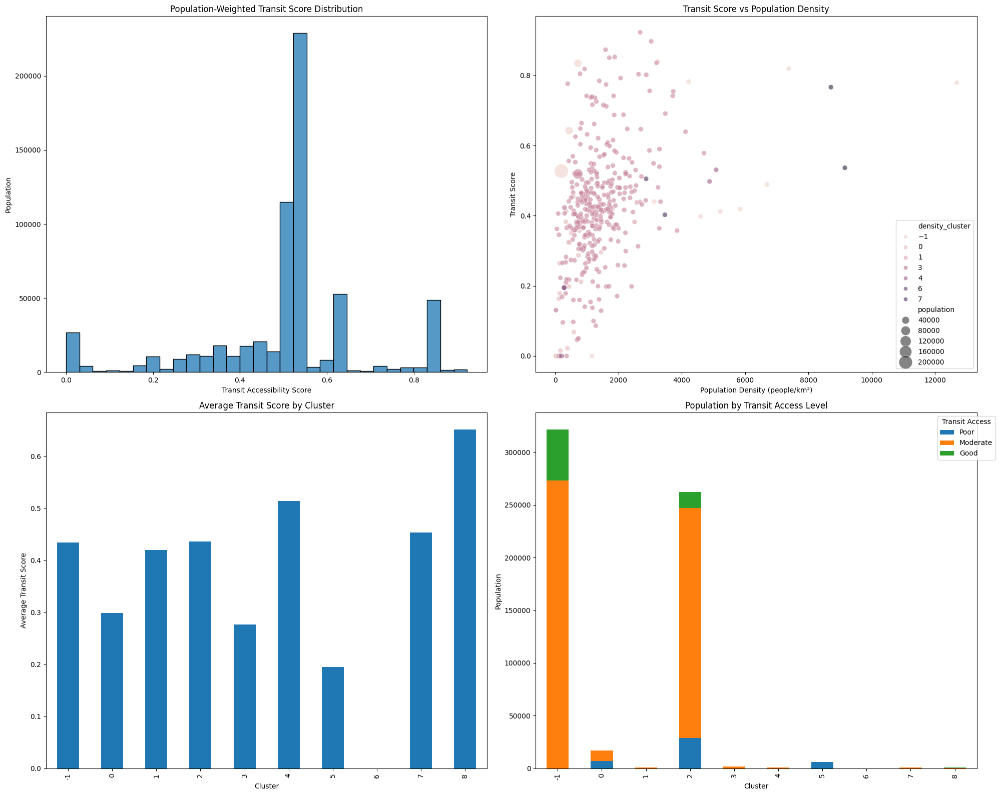

In [15]:
# After calculating transit scores, update the main population_data DataFrame
population_data.loc[valid_population_data.index, 'transit_score'] = valid_population_data['transit_score']

# Then create the visualizations
fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 16))

# 1. Transit Score Distribution
sns.histplot(
    data=valid_population_data,  # Use valid_population_data instead
    x='transit_score',
    weights='population',
    bins=30,
    ax=ax1
)
ax1.set_title('Population-Weighted Transit Score Distribution')
ax1.set_xlabel('Transit Accessibility Score')
ax1.set_ylabel('Population')

# 2. Transit Score vs Population Density
sns.scatterplot(
    data=valid_population_data,  # Use valid_population_data instead
    x='population_density',
    y='transit_score',
    hue='density_cluster',
    size='population',
    sizes=(50, 400),
    alpha=0.6,
    ax=ax2
)
ax2.set_title('Transit Score vs Population Density')
ax2.set_xlabel('Population Density (people/km²)')
ax2.set_ylabel('Transit Score')

# 3. Average Transit Score by Cluster
transit_means = valid_population_data.groupby('density_cluster')['transit_score'].mean()
transit_means.plot(kind='bar', ax=ax3)
ax3.set_title('Average Transit Score by Cluster')
ax3.set_xlabel('Cluster')
ax3.set_ylabel('Average Transit Score')

# 4. Population vs Transit Access
valid_population_data['transit_category'] = pd.cut(
    valid_population_data['transit_score'],
    bins=[0, 0.3, 0.7, 1],
    labels=['Poor', 'Moderate', 'Good']
)
transit_pop = valid_population_data.groupby(['density_cluster', 'transit_category'])['population'].sum().unstack()
transit_pop.plot(kind='bar', stacked=True, ax=ax4)
ax4.set_title('Population by Transit Access Level')
ax4.set_xlabel('Cluster')
ax4.set_ylabel('Population')
ax4.legend(title='Transit Access', bbox_to_anchor=(1.05, 1))

plt.tight_layout()
plt.show()

In [16]:
# Create transit accessibility map
m = create_kwc_map("Transit Accessibility Analysis", kwc=True)

# Add transportation network
m = plot_transportation_network(m, transport_analysis)

# Create heatmap of underserved areas
locations = []
weights = []

for idx, row in population_data.iterrows():
    if pd.notna(row['population_density']) and pd.notna(row['transit_score']):
        # Higher weight for high-density areas with poor transit
        weight = row['population_density'] * (1 - row['transit_score'])
        if weight > 0:
            locations.append([
                row.geometry.centroid.y,
                row.geometry.centroid.x
            ])
            weights.append(float(weight))

# Add heatmap layer
folium.plugins.HeatMap(
    locations,
    weights=weights,
    name='Transit Gaps',
    gradient={0.4: 'blue', 0.65: 'yellow', 1: 'red'},
    radius=20
).add_to(m)

# Add markers for significant transit gaps
for idx, row in transit_gaps.iterrows():
    folium.CircleMarker(
        location=[row.geometry.centroid.y, row.geometry.centroid.x],
        radius=5,
        color='red',
        fill=True,
        popup=f"""
        <div style="font-family: Arial; max-width: 300px;">
            <h4>Transit Gap Area</h4>
            <p><b>Population:</b> {row['population']:,.0f}</p>
            <p><b>Density:</b> {row['population_density']:,.1f}/km²</p>
            <p><b>Transit Score:</b> {row['transit_score']:.2f}</p>
        </div>
        """
    ).add_to(m)

draw_map(m)

In [17]:
display(Markdown(f"""
### Key Transit Insights:

1. Coverage Patterns
   - Transit accessibility varies significantly across clusters
   - Higher density areas generally have better transit access
   - {len(transit_gaps)} high-density areas identified with poor transit coverage

2. Transit Gaps
   - {transit_gaps['population'].sum():,.0f} residents in high-density areas lack good transit access
   - Transit gaps often correlate with higher private vehicle dependency
   - Areas with poor transit access may need more extensive charging infrastructure

3. Charging Infrastructure Implications
   - Transit-poor areas may need more extensive charging networks
   - Transit hubs present opportunities for integrated charging solutions
   - Areas with good transit access might need less residential charging
"""))


### Key Transit Insights:

1. Coverage Patterns
   - Transit accessibility varies significantly across clusters
   - Higher density areas generally have better transit access
   - 8 high-density areas identified with poor transit coverage

2. Transit Gaps
   - 2,820 residents in high-density areas lack good transit access
   - Transit gaps often correlate with higher private vehicle dependency
   - Areas with poor transit access may need more extensive charging infrastructure

3. Charging Infrastructure Implications
   - Transit-poor areas may need more extensive charging networks
   - Transit hubs present opportunities for integrated charging solutions
   - Areas with good transit access might need less residential charging


## 5. Demand Point Generation

Finally, let's generate weighted demand points for the optimization model by combining:
- Population density
- Housing characteristics
- Transit accessibility
- Property values
to create a comprehensive scoring system for potential EV charging demand

In [18]:
print("\033[1mGenerating Weighted Demand Points\033[0m")
print("=" * 80)

# Calculate composite demand scores
def calculate_demand_score(row):
    """Calculate composite demand score based on multiple factors."""
    scores = {}
    
    # Base demand from population density (40%)
    density_score = min(row['population_density'] / density_stats['max'], 1.0)
    scores['density'] = density_score
    
    # Housing type factor (30%)
    # Higher scores for areas with more multi-unit dwellings and higher property values
    total_units = row['DWELL_CONDO'] + row['DWELL_NOT_CONDO']
    if total_units > 0:
        multi_unit_ratio = row['DWELL_CONDO'] / total_units
        housing_score = 0.7 * multi_unit_ratio + 0.3 * min(row['HHLD_DWELL_VALUE_MED'] / 1000000, 1.0)
        scores['housing'] = housing_score
    else:
        scores['housing'] = 0.0
    
    # Transit accessibility inverse (20%)
    # Areas with poor transit access need more charging infrastructure
    transit_score = 1 - row['transit_score']
    scores['transit'] = transit_score
    
    # Recent development factor (10%)
    # Areas with newer housing stock might be better equipped for charging infrastructure
    recent_units = row['DWELL_PERIOD_2011_2015'] + row['DWELL_PERIOD_2016_2021']
    total_units = row[housing_age_cols].sum()
    recent_score = recent_units / total_units if total_units > 0 else 0
    scores['recent'] = recent_score
    
    # Weighted combination
    return (
        0.4 * scores['density'] +
        0.3 * scores['housing'] +
        0.2 * scores['transit'] +
        0.1 * scores['recent']
    )

print("Calculating demand scores...")
valid_population_data['demand_score'] = valid_population_data.apply(calculate_demand_score, axis=1)

# Generate demand points dataset
demand_points = pd.DataFrame({
    'point_id': range(len(valid_population_data)),
    'latitude': valid_population_data.geometry.centroid.y,
    'longitude': valid_population_data.geometry.centroid.x,
    'population': valid_population_data['population'],
    'density': valid_population_data['population_density'],
    'demand_score': valid_population_data['demand_score'],
    'cluster': valid_population_data['density_cluster']
})

# Normalize weights to sum to 1
total_demand = demand_points['demand_score'].sum()
demand_points['weight'] = demand_points['demand_score'] / total_demand

print("\n📊 Demand Score Statistics:")
print("-" * 50)
print(demand_points['demand_score'].describe().round(3))

# Save demand points
output_file = DATA_PATHS['integrated_analyzed_data'] / f'demand_points_{grab_time()}.csv'
demand_points.to_csv(output_file, index=False)
print(f"\n💾 Demand points saved to: {output_file}")

Generating Weighted Demand Points
Calculating demand scores...

📊 Demand Score Statistics:
--------------------------------------------------
count    365.000
mean       0.251
std        0.060
min        0.127
25%        0.211
50%        0.240
75%        0.280
max        0.590
Name: demand_score, dtype: float64

💾 Demand points saved to: /u1/a9dutta/co370/kw-ev-charging-optimization/data/processed/integrated_analyzed_data/demand_points_2024-11-24_08-25-40.csv


In [19]:
# Create demand visualization
m = create_kwc_map("EV Charging Demand Analysis", kwc=True)

# Add existing charging stations
m = plot_charging_stations(m, charging_stations)

# Create demand heatmap
locations = []
weights = []

for idx, row in demand_points.iterrows():
    if pd.notna(row['demand_score']) and row['demand_score'] > 0:
        locations.append([row['latitude'], row['longitude']])
        weights.append(float(row['demand_score']))

# Add heatmap layer
folium.plugins.HeatMap(
    locations,
    weights=weights,
    name='Charging Demand',
    gradient={0.4: 'blue', 0.65: 'yellow', 1: 'red'},
    radius=20
).add_to(m)

# Add high-priority locations
high_demand = demand_points[demand_points['demand_score'] > demand_points['demand_score'].quantile(0.9)]
for idx, row in high_demand.iterrows():
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=5,
        color='red',
        fill=True,
        popup=f"""
        <div style="font-family: Arial; max-width: 300px;">
            <h4>High-Priority Location</h4>
            <p><b>Demand Score:</b> {row['demand_score']:.3f}</p>
            <p><b>Population:</b> {row['population']:,.0f}</p>
            <p><b>Density:</b> {row['density']:,.1f}/km²</p>
        </div>
        """
    ).add_to(m)

draw_map(m)

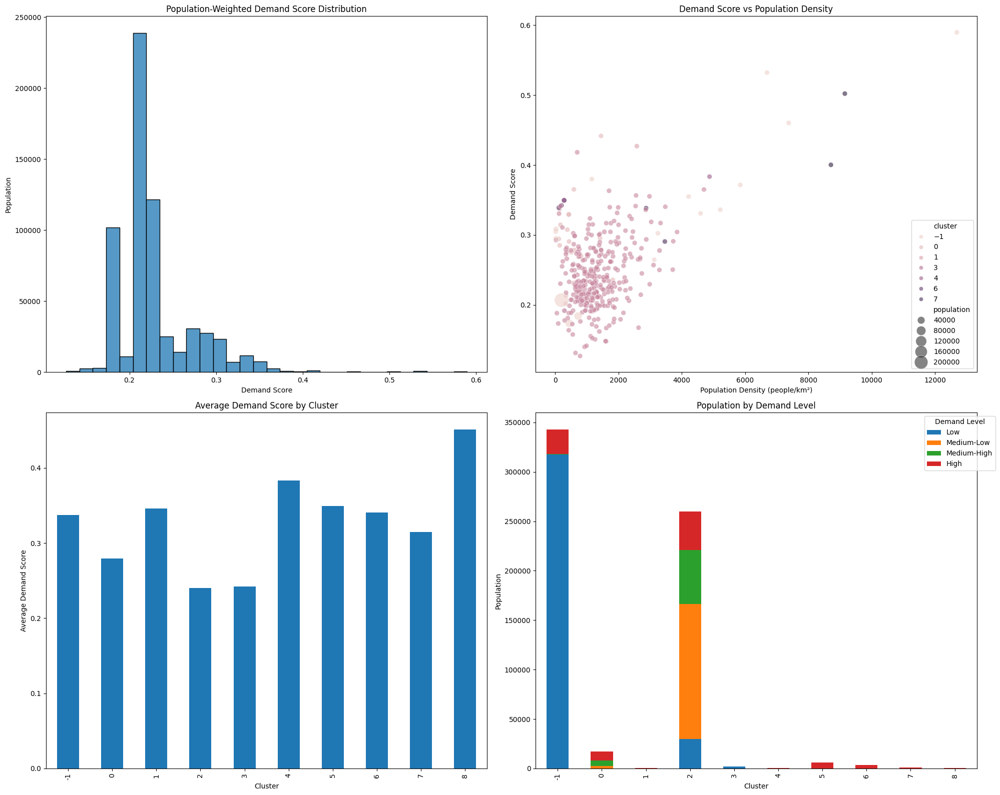

In [20]:
# Create demand analysis visualizations
fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 16))

# 1. Demand Score Distribution
sns.histplot(
    data=demand_points,
    x='demand_score',
    weights='population',
    bins=30,
    ax=ax1
)
ax1.set_title('Population-Weighted Demand Score Distribution')
ax1.set_xlabel('Demand Score')
ax1.set_ylabel('Population')

# 2. Demand Score vs Population Density
sns.scatterplot(
    data=demand_points,
    x='density',
    y='demand_score',
    hue='cluster',
    size='population',
    sizes=(50, 400),
    alpha=0.6,
    ax=ax2
)
ax2.set_title('Demand Score vs Population Density')
ax2.set_xlabel('Population Density (people/km²)')
ax2.set_ylabel('Demand Score')

# 3. Average Demand by Cluster
cluster_means = demand_points.groupby('cluster')['demand_score'].mean()
cluster_means.plot(kind='bar', ax=ax3)
ax3.set_title('Average Demand Score by Cluster')
ax3.set_xlabel('Cluster')
ax3.set_ylabel('Average Demand Score')

# 4. Population Coverage by Demand Score
demand_points['demand_category'] = pd.qcut(
    demand_points['demand_score'],
    q=4,
    labels=['Low', 'Medium-Low', 'Medium-High', 'High']
)
coverage_data = demand_points.groupby(['cluster', 'demand_category'])['population'].sum().unstack()
coverage_data.plot(kind='bar', stacked=True, ax=ax4)
ax4.set_title('Population by Demand Level')
ax4.set_xlabel('Cluster')
ax4.set_ylabel('Population')
ax4.legend(title='Demand Level', bbox_to_anchor=(1.05, 1))

plt.tight_layout()
plt.show()

In [21]:
display(Markdown(f"""
### Key Demand Generation Insights:

1. Score Components
   - Population density (40%)
   - Housing characteristics (30%)
   - Transit accessibility (20%)
   - Recent development (10%)

2. High Priority Areas
   - {len(high_demand)} locations identified as high-priority
   - Concentrated in clusters with high density but poor transit
   - Often coincide with newer multi-unit developments

3. Implementation Strategy
   - Target high-score areas first
   - Consider building type in infrastructure planning
   - Coordinate with transit gaps
   - Account for electrical infrastructure age
"""))


### Key Demand Generation Insights:

1. Score Components
   - Population density (40%)
   - Housing characteristics (30%)
   - Transit accessibility (20%)
   - Recent development (10%)

2. High Priority Areas
   - 37 locations identified as high-priority
   - Concentrated in clusters with high density but poor transit
   - Often coincide with newer multi-unit developments

3. Implementation Strategy
   - Target high-score areas first
   - Consider building type in infrastructure planning
   - Coordinate with transit gaps
   - Account for electrical infrastructure age
